In [9]:
import numpy as np
import pandas as pd
import sklearn as skit
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.model_selection import ParameterGrid
import random
from numpy import exp, array, random, dot

In [10]:
data = pd.read_csv("data.csv")

In [11]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 348 entries, 0 to 347
Data columns (total 17 columns):
handicapped-infants                       348 non-null float64
water-project-cost-sharing                348 non-null float64
adoption-of-the-budget-resolution         348 non-null float64
physician-fee-freeze                      348 non-null float64
el-salvador-aid                           348 non-null float64
religious-groups-in-schools               348 non-null float64
anti-satellite-test-ban                   348 non-null float64
aid-to-nicaraguan-contras                 348 non-null float64
mx-missile                                348 non-null float64
immigration                               348 non-null float64
synfuels-corporation-cutback              348 non-null float64
education-spending                        348 non-null float64
superfund-right-to-sue                    348 non-null float64
crime                                     348 non-null float64
duty-free-exp

In [12]:
strc = data.select_dtypes(['object']).columns
floatc = data.select_dtypes(['float64']).columns
data[strc] = data[strc].astype('category').apply(lambda x: x.cat.codes)
data[strc] = data[strc].astype('category').apply(lambda x: x.cat.codes)

In [13]:
data

,handicapped-infants,water-project-cost-sharing,adoption-of-the-budget-resolution,physician-fee-freeze,el-salvador-aid,religious-groups-in-schools,anti-satellite-test-ban,aid-to-nicaraguan-contras,mx-missile,immigration,synfuels-corporation-cutback,education-spending,superfund-right-to-sue,crime,duty-free-exports,export-administration-act-south-africa,politic
0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1
1,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1
2,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0
3,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0
4,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1
344,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1
345,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0
346,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0


In [14]:
from sklearn.tree import DecisionTreeClassifier
Xdata = data.iloc[:,0:16]
ydata = data.iloc[:,[16]]
rds = 3
import sklearn.metrics as metrics
def split_data(Xdata, ydata, ratio=0.25, rd_seed=rds): #funkce na rozdeleni dat
    Xtrain, Xtest, ytrain, ytest = train_test_split(Xdata, ydata, test_size=0.25, random_state=rd_seed) 
    Xtrain, Xval, ytrain, yval = train_test_split(Xtrain, ytrain, test_size=0.25, random_state=rd_seed) 
    return Xtrain, Xtest, Xval, ytrain, ytest, yval
Xtrain, Xtest, Xval, ytrain, ytest, yval = split_data(Xdata, ydata)

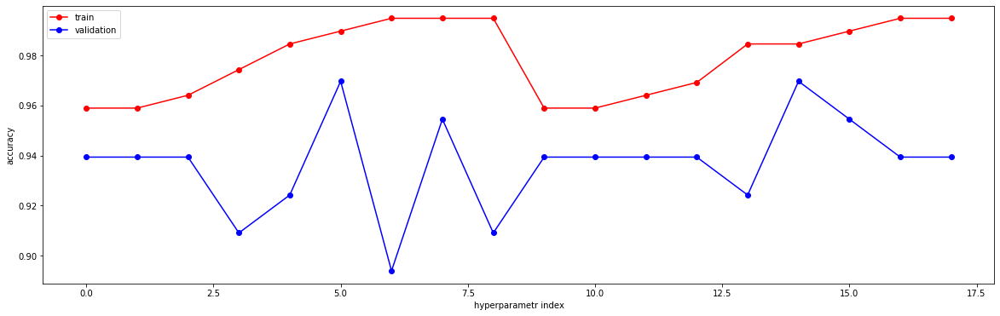

In [15]:
param_grid = {
    'max_depth': range(1, 10),
    'criterion': ['gini', 'entropy']
}
param_comb = ParameterGrid(param_grid)
val_acc = []
train_acc = []
for params in param_comb:
    dt = DecisionTreeClassifier(max_depth=params['max_depth'], criterion=params['criterion'])
    dt.fit(Xtrain, ytrain.values.ravel())
    train_acc.append(metrics.accuracy_score(ytrain, dt.predict(Xtrain)))
    val_acc.append(metrics.accuracy_score(yval, dt.predict(Xval)))
plt.figure(figsize=(20,6))
plt.plot(train_acc,'or-')
plt.plot(val_acc,'ob-')
plt.xlabel('hyperparametr index')
plt.ylabel('accuracy')
plt.legend(['train', 'validation'])

In [16]:
best_params = param_comb[np.argmax(val_acc)]
best_params


{'max_depth': 6, 'criterion': 'gini'}

[Text(1221.7263157894736, 1211.4514285714286, 'physician-fee-freeze <= 0.5\ngini = 0.482\nsamples = 195\nvalue = [116, 79]\nclass = y[0]'),
 Text(375.9157894736842, 1025.074285714286, 'crime <= 0.5\ngini = 0.035\nsamples = 112\nvalue = [110, 2]\nclass = y[0]'),
 Text(187.9578947368421, 838.6971428571429, 'gini = 0.0\nsamples = 75\nvalue = [75, 0]\nclass = y[0]'),
 Text(563.8736842105263, 838.6971428571429, 'synfuels-corporation-cutback <= 0.5\ngini = 0.102\nsamples = 37\nvalue = [35, 2]\nclass = y[0]'),
 Text(375.9157894736842, 652.32, 'aid-to-nicaraguan-contras <= 0.5\ngini = 0.245\nsamples = 14\nvalue = [12, 2]\nclass = y[0]'),
 Text(187.9578947368421, 465.9428571428572, 'gini = 0.0\nsamples = 6\nvalue = [6, 0]\nclass = y[0]'),
 Text(563.8736842105263, 465.9428571428572, 'adoption-of-the-budget-resolution <= 0.5\ngini = 0.375\nsamples = 8\nvalue = [6, 2]\nclass = y[0]'),
 Text(375.9157894736842, 279.5657142857142, 'gini = 0.0\nsamples = 1\nvalue = [0, 1]\nclass = y[1]'),
 Text(751.83

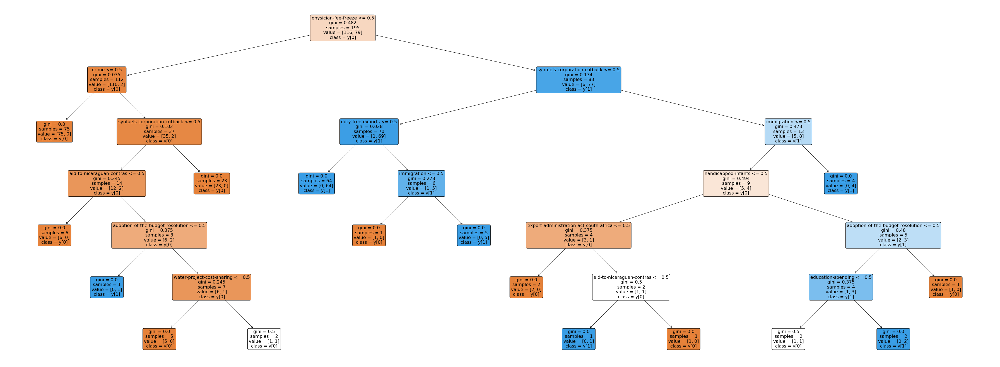

In [17]:
clf = DecisionTreeClassifier(**best_params)
clf.fit(Xtrain,ytrain)
from sklearn.tree import DecisionTreeClassifier, plot_tree
plt.figure(figsize=(64,24))
plot_tree(clf, filled=True, feature_names=Xtrain.columns, class_names=True, rounded=True)

In [96]:
ls = Xtrain.columns
input1 = []
#rules
if (data['physician-fee-freeze'] > 0.5 and data['synfuels-corporation-cutback'] and data['aid-to-nicaraguan-contras'] <= 0.5 and
data['adoption-of-the-budget-resolution'] > 0.5):
    print(1)
elif data['physician-fee-freeze'] > 0.5 and data['synfuels-corporation-cutback'] > 0.5 and data['duty-free-exports'] <= 0.5 and data['immigration'] > 0.5:
    print(0)
elif data['physician-fee-freeze'] > 0.5 and data['synfuels-corporation-cutback'] <= 0.5 and data['immigration'] <= 0.5 and data['handicapped-infants'] <= 0.5 and data['adoption-of-the-budget-resolution'] <=0.5:
    print(0)
elif data['physician-fee-freeze'] > 0.5 and data['synfuels-corporation-cutback'] <= 0.5 and data['immigration'] <= 0.5 and data['handicapped-infants'] <= 0.5 and data['adoption-of-the-budget-resolution'] > 0.5 and data['education-spending'] > 0.5:
    print(0)
elif data['physician-fee-freeze'] > 0.5 and data['synfuels-corporation-cutback'] <= 0.5 and data['immigration'] <= 0.5 and data['handicapped-infants'] > 0.5 and data['education-spending'] > 0.5:
    print(0)
elif data['physician-fee-freeze'] > 0.5 and data['synfuels-corporation-cutback'] <= 0.5 and data['immigration'] <= 0.5 and data['handicapped-infants'] > 0.5 and data['education-spending'] <= 0.5 and data['crime'] > 0.5:
    print(0)
else: 
    if 

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

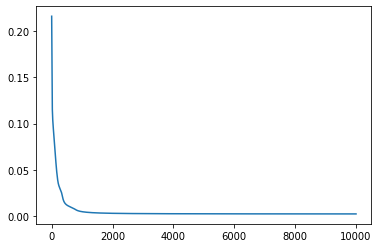

In [18]:
X=Xtrain
y=1.0*ytrain


# Activation function
def tanh(x, deriv=False):
    if (deriv):
        return 1.0-x**2
    x=(np.exp(x)-np.exp(-x))/(np.exp(x)+np.exp(-x))
    return x

def softmax(x, deriv=False):
    if (deriv):
        return sft1(x)*(1-sft1(x))
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum(axis=0)

def sft1(x):
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum(axis=0)

    

class NeuralNetwork:
    def __init__(self, x,y):
        self.input = x
        self.weights1= 2 *np.random.rand(self.input.shape[1],8)-1 
        self.weights2 = 2*np.random.rand(8,2)-1
        self.sft = 2*np.random.rand(2,1)-1
        self.y = y
        self.output = 0.0*np. zeros(y.shape)
        
    def feedforward(self):
        self.layer1 = tanh(np.dot(self.input, self.weights1))
        self.layer2 = tanh(np.dot(self.layer1, self.weights2))
        self.eval = tanh(np.dot(self.layer2, self.sft))
        return self.eval
        
    def backprop(self):
        err = self.y - self.output
        lsc = err*tanh(self.eval, deriv=True)
        
        erl2 = lsc.dot(self.sft.T)
        l2c = erl2*tanh(self.layer2, deriv=True)
        
        erl1 = l2c.dot(self.weights2.T)
        l1c = erl1*tanh(self.layer1, deriv=True)
        
        
        self.sft += 0.003*self.layer2.T.dot(lsc)
        self.weights2 += 0.003*self.layer1.T.dot(l2c)
        self.weights1 += 0.003*self.input.T.dot(l1c)
        
        
        

        
        #erl2 = self.y - self.output
        
        #l2c = erl2*softmax(self.layer2, deriv = True)
        
        #erl1 = l2c.dot(self.weights2.T)
        
        #l1c = erl1*tanh(self.layer1,deriv=True)
        
        #self.weights2 += 0.01*self.layer1.T.dot(l2c)
        
        #self.weights1 += 0.01*self.input.T.dot(l1c)
        

        
    def train(self, X, y):
        self.output = self.feedforward()
        self.backprop()
        

NN = NeuralNetwork(X,y)
arr = []
mrr = []
for i in range(10000):
    NN.train(X, y)
    arr.append((np.mean(np.square(y - NN.feedforward()))))
plt.plot(arr)

In [19]:
X.shape[1]
#print ("Actual Output: \n" + str(NN.y))

16

In [24]:
kk = []
for i in NN.feedforward():
    kk.append(np.round(i).astype(int))
#print ("Predicted Output: \n" + str(NN.feedforward()))
ll = []
for j in kk:
    ll.append(j[0])
ll

[0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0]

In [25]:
print ("Loss: \n" + str(np.mean(np.square(kk - NN.feedforward())))) # mean sum squared loss

Loss: 
0.0026405209058485354


In [26]:
y.head(25)

,politic
310,0.0
54,0.0
118,0.0
99,1.0
219,0.0
228,0.0
283,0.0
183,1.0
153,0.0
57,0.0


In [45]:
i = 0
nw
while (i < 8):
    for j in NN.weights1[i]:
        print(j)
    print('  ')

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.04644

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.037372

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.23

-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912

-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.062

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.810

-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.04668

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995

0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.54677

0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.832

-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.235

1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002133832128385
-0.37466693129015927
-0.2308000110354658
1.0625431679375203
-0.2956265907744358
0.23803623689609824
-0.81059096506569
-1.0464406760430702
  
0.23556518428832698
-0.1208992053291724
-0.8320828885993984
0.5912589389485274
-0.6995279200507519
0.5467721785741182
1.046687409952502
-0.03737220824537525
-0.5002

KeyboardInterrupt: 

In [56]:
w1 = NN.weights1.to_numpy()
NN.sft

array([[-1.84997505],
       [ 1.85089163]])

Error:0.4964100319027255


NameError: name 'f' is not defined

In [95]:
list = []
list.append(1)
print(list[0])

1


Index(['handicapped-infants', 'water-project-cost-sharing',
       'adoption-of-the-budget-resolution', 'physician-fee-freeze',
       'el-salvador-aid', 'religious-groups-in-schools',
       'anti-satellite-test-ban', 'aid-to-nicaraguan-contras', 'mx-missile',
       'immigration', 'synfuels-corporation-cutback', 'education-spending',
       'superfund-right-to-sue', 'crime', 'duty-free-exports',
       'export-administration-act-south-africa'],
      dtype='object')